In [2]:
import os
import numpy as np

import torch
import dataset
import easydict
import argparse
import network
import utils
import torchaudio

from torch.utils.data import DataLoader

import matplotlib.pyplot as plt
import IPython.display as ipd

In [3]:
os.environ["CUDA_VISIBLE_DEVICES"] = "2"

In [4]:
opt = easydict.EasyDict({
    "data_dir": '/data1/singing_inpainting/dataset',
    "input_length": 220500,
    "image_height": 513,
    "image_width": 431,
    "bbox_shape": 120,
    "num_workers": 4,
    "batch_size": 1,
    "mask_type" : 'time',
    "load_name" : '/data2/personal/jaejun/inpainting/results/210718/time2/models/deepfillv2_WGAN_epoch26_batchsize4.pth',
    "sample_path" : '/data2/personal/jaejun/inpainting/results/210718/time2/validation26',
    "in_channels" : 2,
    "out_channels" : 1,
    "latent_channels" : 64,
    "pad_type": 'zero',
    "activation": 'lrelu',
    "norm": 'in',
    })

In [5]:
testset = dataset.InpaintDataset(opt, split='VALID')
print('The overall number of images equals to %d' % len(testset))
dataloader = DataLoader(testset, batch_size = opt.batch_size, pin_memory = True)


The overall number of images equals to 738


In [6]:
model = network.GatedGenerator(opt)
if opt.load_name:
    model.load_state_dict(torch.load(opt.load_name))
    model.cuda()
# model = torch.load(opt.load_name)


In [7]:
gflim = torchaudio.transforms.GriffinLim(n_fft=1024, n_iter=60, win_length=1024, hop_length=512)
relu = torch.nn.ReLU()

In [10]:
# def gflim(normalized_lin):
#     win = 1024
#     def mag(S):
#         real = S[...,:1]
#         imag = S[...,1:]
#         m = real**2 + imag**2
#         m = torch.sqrt(m+1e-5)
#         return m
# #     l_mag = (10**normalized_lin)
#     l_mag = normalized_lin
#     l_mag = l_mag.unsqueeze(-1)
#     l_phase = 2 * np.pi * torch.rand_like(l_mag) - np.pi
#     real = l_mag * torch.cos(l_phase)
#     imag = l_mag * torch.sin(l_phase)
#     S = torch.cat((real, imag), axis=-1)
#     S_mag = mag(S)
#     for i in range(100):
#         x = torch.istft(S, n_fft=win, hop_length=512, win_length=win, window=torch.hann_window(win))
#         S_new = torch.stft(x, n_fft=win, hop_length=512, win_length=win, window=torch.hann_window(win))
#         S_new_phase = S_new/mag(S_new)
#         S = S_mag * S_new_phase
#     return x

# def mag(S):
#     real = S[...,:1]
#     imag = S[...,1:]
#     m = real**2 + imag**2
#     m = torch.sqrt(m+1e-5)
#     return m

In [11]:
# # audio_mag = mag(torch.stft(audio[0], n_fft=1024, hop_length=512, win_length=1024, window=torch.hann_window(1024)))
# audio_mag = mag(torch.stft(audio[0], n_fft=2048, hop_length=512, win_length=2048, window=torch.hann_window(2048)))
# # audio_mag = audio_mag.log10()

In [99]:
audio_gf = griffin_lim_torch(audio_mag[0,:,:,0])
audio_gf_torch = gflim(audio_mag[0,:,:,0])

In [100]:
ipd.Audio(audio_gf, rate=44100)

In [101]:
ipd.Audio(audio_gf_torch, rate=44100)

/home/jjlee0721/inpainting/code/utils.py:144: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(2, 4)


NameError: name 'stop' is not defined

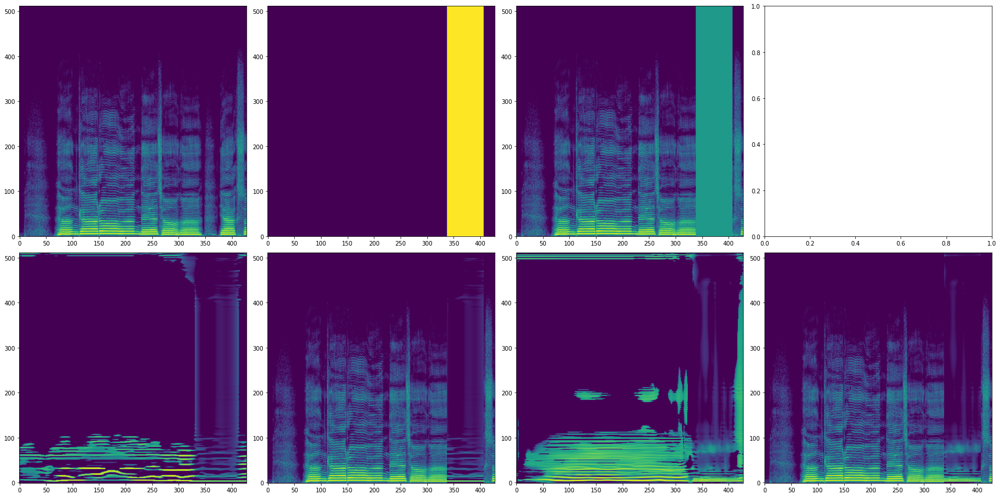

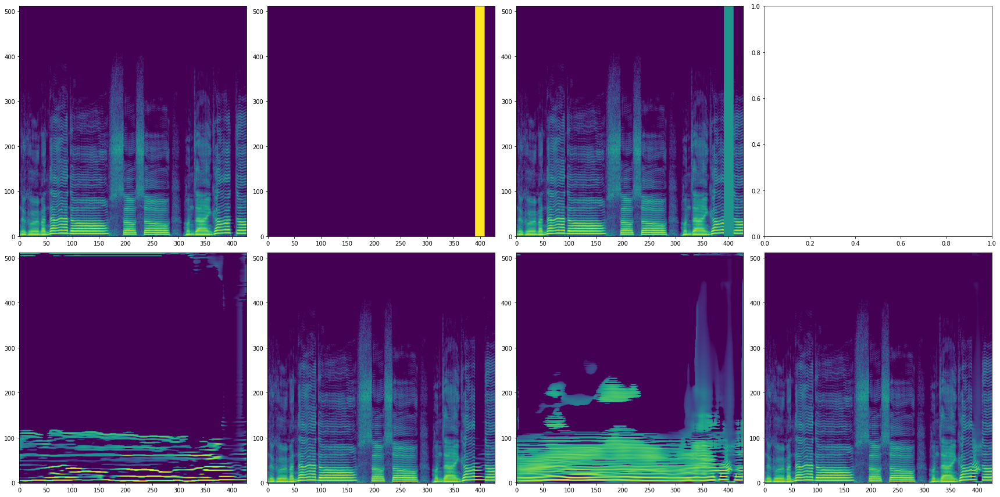

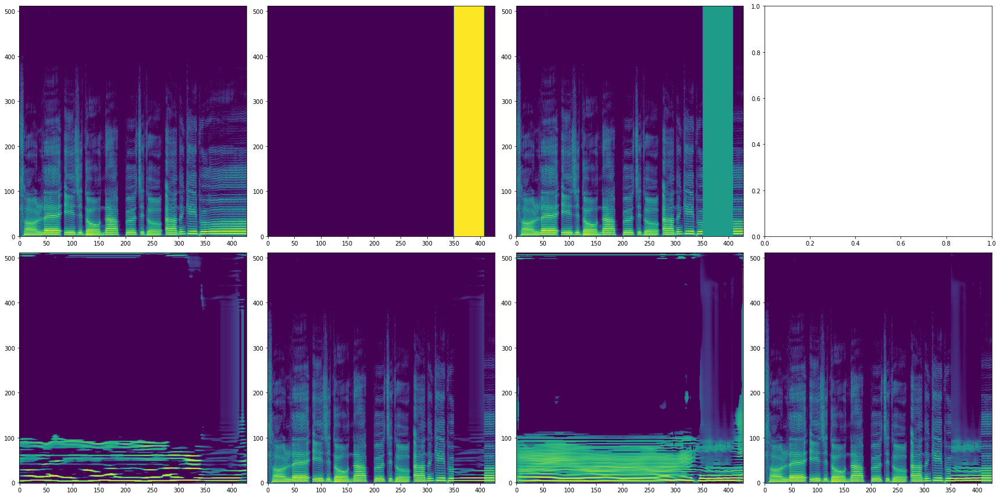

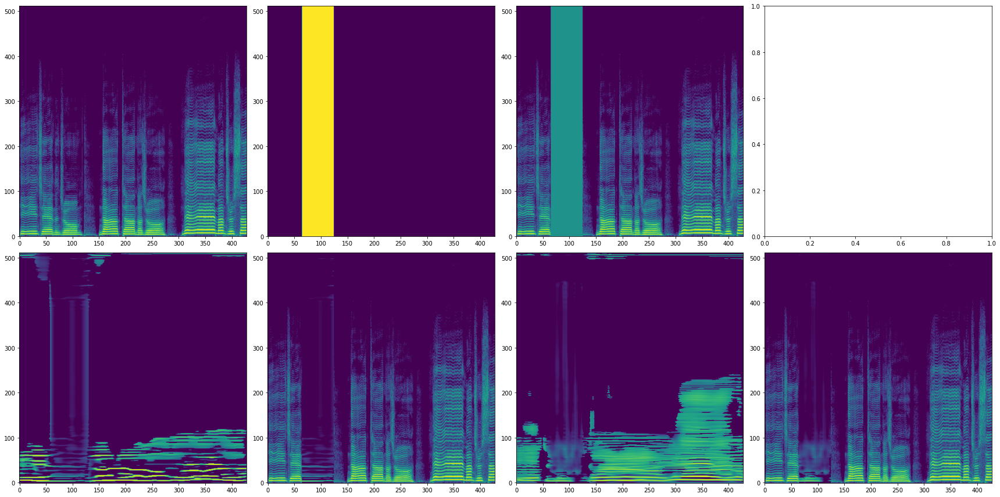

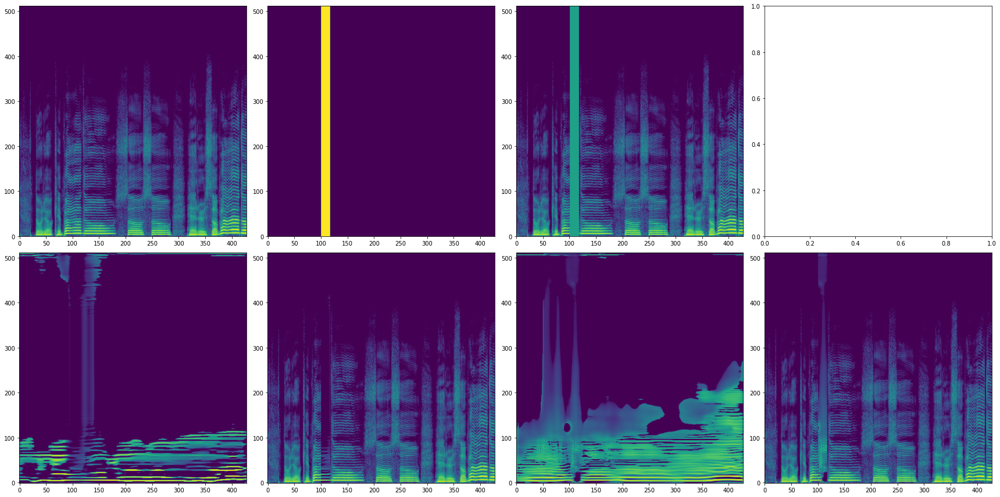

...

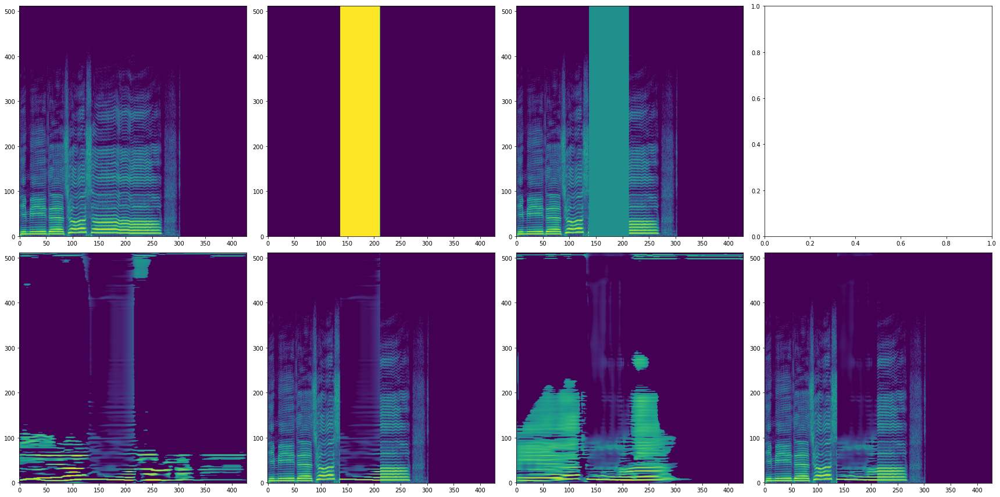

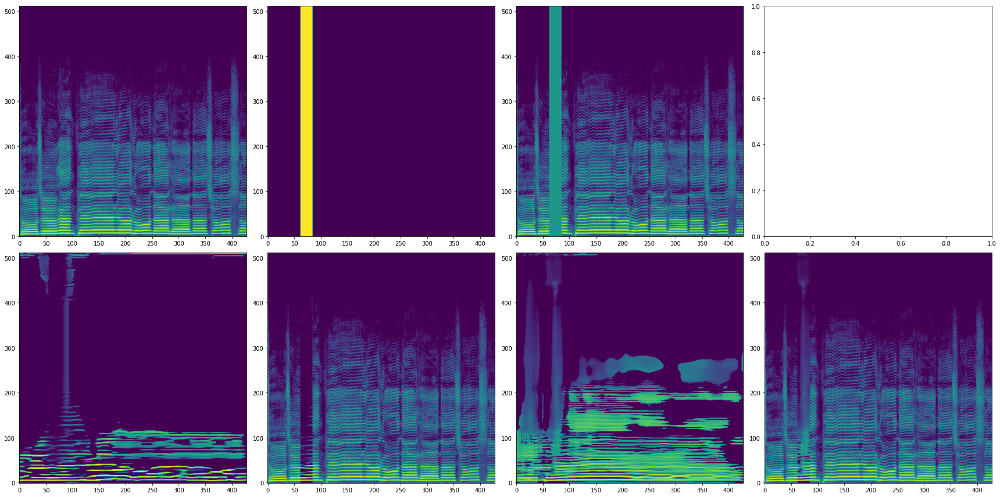

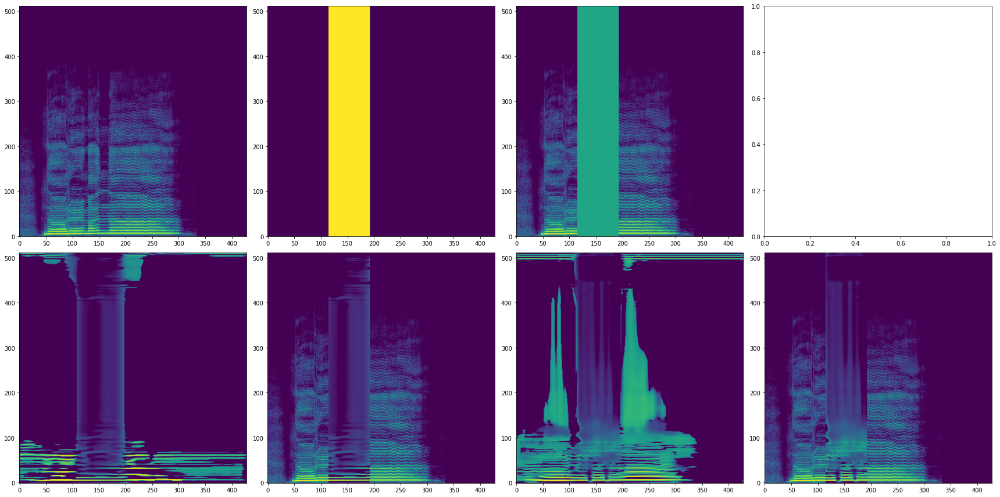

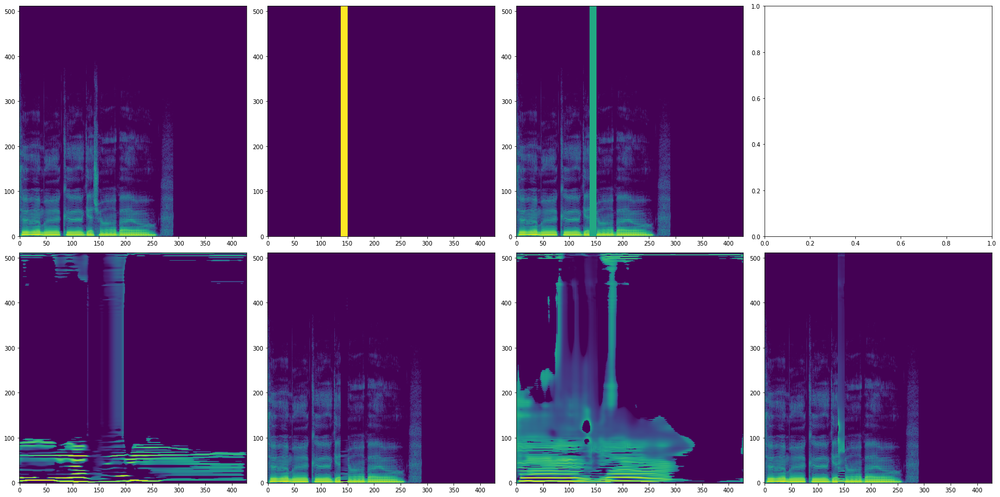

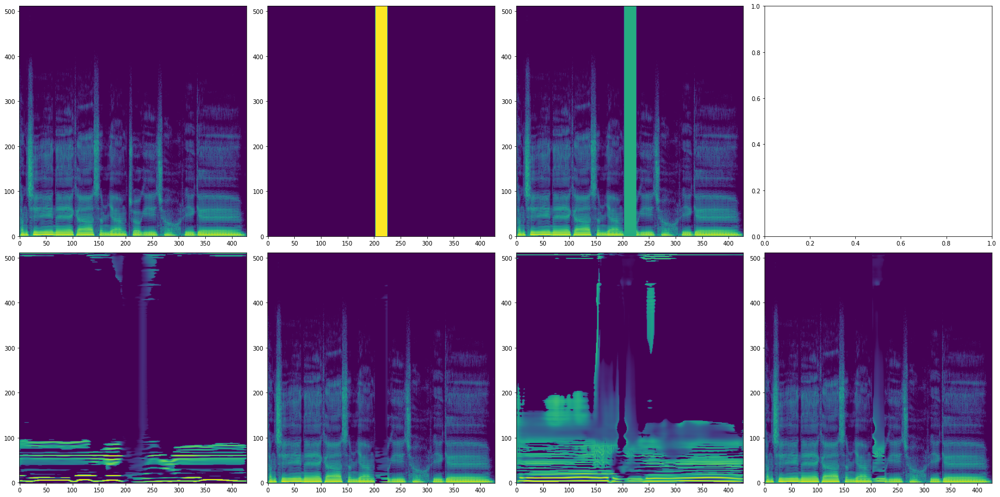

In [8]:
for batch_idx, (audio, img, mask) in enumerate(dataloader):
    if batch_idx > 50:
        stop
    sample_folder = opt.sample_path
    scaler = 1
    img = img / scaler
    img = img[:,:,:512,:428]

    img = img.cuda()
    mask = mask[:,:,:512,:428]
    mask = mask.cuda()    

    first_out, second_out = model(img, mask)
    first_out_wholeimg = img * (1 - mask) + first_out * mask        # in range [0, 1]
    second_out_wholeimg = img * (1 - mask) + second_out * mask  
    
    gt = img[0,0,:,:] * scaler
    mask = mask[0,0,:,:]
    masked_gt = gt * (1 - mask) + mask
    masked_gt = masked_gt * scaler
    first = first_out[0,0,:,:] * scaler
    firsted_img = gt * (1 - mask) + first * mask
    second = second_out[0,0,:,:] * scaler
    seconded_img = gt * (1 - mask) + second * mask    

    img_list = [gt, mask, masked_gt, first, firsted_img, second, seconded_img]

    gt = gt.detach().cpu()
    masked_gt = gt * (1 - mask.detach().cpu())
    second = second.detach().cpu()
    seconded_img = seconded_img.detach().cpu()
    
    gt_pad = torch.nn.functional.pad(gt, (0, 3, 0, 1), mode='constant', value=0)
    masked_gt_pad = torch.nn.functional.pad(masked_gt.detach().cpu(), (0, 3, 0, 1), mode='constant', value=0)
    second_pad = torch.nn.functional.pad(second, (0, 3, 0, 1), mode='constant', value=0)
    seconded_img_pad = torch.nn.functional.pad(seconded_img, (0, 3, 0, 1), mode='constant', value=0)
    
    gfl_gt_pad = gflim(gt_pad)
    gfl_masked_gt_pad = gflim(relu(masked_gt_pad))
    gfl_second_pad = gflim(relu(second_pad))
    gfl_second_img_pad = gflim(relu(seconded_img_pad))
    
    utils.save_samples(sample_folder = sample_folder, sample_name = str(batch_idx), img_list = img_list, scaler = scaler)
    
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_gt.wav'), audio[0], sample_rate=44100)
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_gt_gflim.wav'), gfl_gt_pad.unsqueeze(0), sample_rate=44100)
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_gt_masked_gflim.wav'), gfl_masked_gt_pad.unsqueeze(0), sample_rate=44100)
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_pred_gfli.wav'), gfl_second_pad.unsqueeze(0), sample_rate=44100)
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_pred_gflim.wav'), gfl_second_img_pad.unsqueeze(0), sample_rate=44100)



In [38]:
test = seconded_img * mask.detach().cpu()
test = torch.nn.functional.pad(test, (0, 3, 0, 1), mode='constant', value=0)

In [48]:
test_grf = gflim(test + 1e-8)

In [49]:
ipd.Audio(test_grf, rate=44100)

In [17]:
first_out.min()

tensor(-0.0366, device='cuda:0', grad_fn=<MinBackward1>)

In [16]:
gt_pad.min(), gt_pad.max(), relu(second_pad).min(), relu(second_pad).max()

(tensor(0.), tensor(8059.1152), tensor(0.), tensor(1740.1434))

In [51]:
ipd.Audio(gf_b, rate=44100)

In [55]:
b = torch.nn.functional.pad(a[0][0], (0, 3, 0, 1), mode='constant', value=0)

In [52]:
gf_b.shape

torch.Size([218624])

In [56]:
b.shape

torch.Size([513, 431])